 # Modelado de temas para los años 2019 comparado con 2020 de Noticias en twitter
 
## Adquisición de datos
 
 ### Cuentas de twitter tenidas en cuenta
* Noticias Caracol - @NoticiasCaracol
* Noticias RCN - @NoticiasRCN
* Noticentro1 CM& - @CMILANOTICIA
* CityTV - @Citytv
* El tiempo - @ELTIEMPO
* El espectador - @elespectador
* Publimetro @PublimetroCol
* El Nuevo Siglo - @ElNuevoSiglo
* Diario ADN - @adncolombia
* La Nación - @PrensaLaNacion
* El colombiano - @elcolombiano
* Periódico El Mundo - @elmundomedellin
* El Heraldo - @elheraldoco
* Portafolio - @Portafolioco

In [197]:
import pandas as pd
import numpy as np
import re
import regex
import emoji

import tweepy
import json

import snscrape.modules.twitter as sntwitter

from IPython.core.display import display, HTML

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.pipeline import make_pipeline
from sklearn.decomposition import TruncatedSVD

import matplotlib.pyplot as plt
import plotly.express as px
%matplotlib inline
init_notebook_mode(connected=True)

import pyLDAvis.gensim_models
from gensim.models import LdaModel
from gensim.corpora import Dictionary
from pprint import pprint
import warnings; warnings.simplefilter('ignore')
from nltk.corpus import stopwords
stopwords_es = stopwords.words('spanish')

D:\anaconda3\lib\site-packages\scipy\sparse\sparsetools.py:21: DeprecationWarning:

`scipy.sparse.sparsetools` is deprecated!
scipy.sparse.sparsetools is a private module for scipy.sparse, and should not be used.



In [2]:
with open('../Access/client_secret.json') as file:
    CREDS = json.load(file)
    
# Auth v1
auth = tweepy.OAuthHandler(CREDS['api_key'], CREDS['api_secret_key'])
api = tweepy.API(auth, wait_on_rate_limit=True)

In [3]:
news_user_names = ['NoticiasCaracol', 'NoticiasRCN', 'CMILANOTICIA',
                   'Citytv', 'ELTIEMPO', 'elespectador', 'PublimetroCol',
                   'ElNuevoSiglo', 'adncolombia', 'PrensaLaNacion',
                   'elcolombiano', 'elmundomedellin', 'elheraldoco', 'Portafolioco']

In [4]:
def get_user_data(api, screen_name):
    """
    Gets specific twitter user data:
    * Name
    * Description
    * Banner Image
    * Tweet count
    
    parameters:
    __________
    
    api: twitter API wrapper
    screen_name: identifier of the twitter account (the one that is folowed by "@")
    
    Returns:
    Dictionary holding the above information
    """

    params = dict(screen_name = screen_name)
    response = api.get_user(**params)._json
    Keys = ['name', 'description', 'profile_banner_url', 'statuses_count']
    return {key: response[key] for key in Keys}

def print_user_data(info):
    """
    Display information for a twitter user
    
    Parameters:
    __________
    
    info: dictionary containing the following information about a twitter user: name,
        description and background image
    """
    
    html = f"""
    <img src="{info['profile_banner_url']}">
    <p style = "font-size: 50px">{info['name']}</p>
    <p>{info['description']}</p>
    <p> No tweets: {info['statuses_count']}</p>
    """
    display(HTML(html))
    
def pre_process(text):
    text = text.lower()
    text = re.sub(r'[\W\d_]+',' ', text)
    text = [word for word in text.split() if word not in stopwords_es]
    return " ".join(text) # no es un error

pattern1 = '?P<pic>pic.twitter.com/[^\s]+'
pattern2 = '?P<url>https?://[^\s]+'

def text_clean(row):
    text = row['content']
    
    links = [tuple(j for j in i if j)[-1] for i in re.findall(f"({pattern1})|({pattern2})",text)]
    for link in links:
        text = text.replace(link,"")
             
    hashtags = [interaction for interaction in text.split() if interaction.startswith("#")]
    for hashtag in hashtags:
        text = text.replace(hashtag,"")
        
    mentions = [interaction for interaction in text.split() if interaction.startswith("@")]
    for mention in mentions:
        text = text.replace(mention,"")
        
    emoji_list = []
    data = regex.findall(r'\X', text)
    for word in data:
        if any(char in emoji.UNICODE_EMOJI['en'] for char in word):
            emoji_list.append(word)
            text = text.replace(word,"")
        
    pp = pre_process(text)
    return text, pp, emoji_list

In [8]:
for twitter_user in news_user_names:
    print_user_data(get_user_data(api, twitter_user))
    print("*"*50)

**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


**************************************************


In [20]:
%%time
tweets = []
for tweet_user in news_user_names:
    print(f'{tweet_user} started processing...')
    cnt = 0
    for i, tweet in enumerate(sntwitter.TwitterSearchScraper(f'(from:{tweet_user})' + f'since:2019-01-01 until:2020-12-31 -filter:replies').get_items()) :
        temp = []
        temp.append(tweet_user)
        temp.append(tweet.date)
        temp.append(tweet.content)

        tweets.append(temp)
        cnt += 1
    print(f'{tweet_user} user process finalized. {cnt} tweets loaded.')

NoticiasCaracol started processing...
NoticiasCaracol user process finalized. 106008 tweets loaded.
NoticiasRCN started processing...
NoticiasRCN user process finalized. 99610 tweets loaded.
CMILANOTICIA started processing...
CMILANOTICIA user process finalized. 37156 tweets loaded.
Citytv started processing...
Citytv user process finalized. 60864 tweets loaded.
ELTIEMPO started processing...
ELTIEMPO user process finalized. 91948 tweets loaded.
elespectador started processing...
elespectador user process finalized. 170669 tweets loaded.
PublimetroCol started processing...
PublimetroCol user process finalized. 53101 tweets loaded.
ElNuevoSiglo started processing...
ElNuevoSiglo user process finalized. 23330 tweets loaded.
adncolombia started processing...
adncolombia user process finalized. 4172 tweets loaded.
PrensaLaNacion started processing...
PrensaLaNacion user process finalized. 13508 tweets loaded.
elcolombiano started processing...
elcolombiano user process finalized. 34193 twe

In [21]:
tweets = pd.DataFrame(tweets)
tweets.columns = ['user','date', 'content']
tweets.to_csv('../datasets/tweets_news.csv', index = False)

In [5]:
tweets = pd.read_csv('../datasets/tweets_news.csv', engine = 'c', header = 0, parse_dates = ['date'])

In [6]:
tweets[['text_clean', 'pp', 'emojis']] = tweets.apply(text_clean, axis=1, result_type='expand')

In [184]:
tweets.sample(6)

,user,date,content,text_clean,pp,emojis
779225,Portafolioco,2020-06-23 08:00:26+00:00,La Unión Europea enviará donación a Colombia p...,La Unión Europea enviará donación a Colombia p...,unión europea enviará donación colombia atenci...,[👉]
558328,elespectador,2019-02-02 16:55:00+00:00,Abusos sexuales se multiplican en las academia...,Abusos sexuales se multiplican en las academia...,abusos sexuales multiplican academias militare...,[]
769010,elheraldoco,2019-01-03 08:30:01+00:00,#LasMásCompartidas | Conmoción en Argentina: M...,| Conmoción en Argentina: Menor de 14 años fu...,conmoción argentina menor años violada cinco h...,[]
565311,elespectador,2019-01-05 00:50:39+00:00,Yony González llegó a Río de Janeiro para firm...,Yony González llegó a Río de Janeiro para firm...,yony gonzález llegó río janeiro firmar fluminense,[]
99518,NoticiasCaracol,2019-02-11 11:17:56+00:00,Cronología de la #EmergenciaEnHidroituango. Lo...,Cronología de la Los momentos de mayor tensió...,cronología momentos mayor tensión represa,[]
377089,ELTIEMPO,2019-05-22 23:45:06+00:00,Comandante de la Segunda División responde afi...,Comandante de la Segunda División responde afi...,comandante segunda división responde afirmacio...,[]


In [8]:
tweets['date'].dt.year.value_counts()

2019    407847
2020    397654
Name: date, dtype: int64

## Gráficas

In [188]:
temp = tweets['date'].groupby([tweets['date'].dt.year.rename('year'),
                               tweets['date'].dt.month.rename('month')]).agg({'count'}).reset_index()
month_names = {1:'Ene', 2:'Feb', 3:'Mar', 4:'Abr', 5:'May', 6:'Jun',
               7:'Jul', 8:'Ago', 9:'Sep', 10:'Oct',11:'Nov',12:'Dic'}

In [99]:
mean_2019_tweets = temp[temp['year'] == 2019]['count'].mean()
mean_2020_tweets = temp[temp['year'] == 2020]['count'].mean()

In [189]:
fig = px.bar(temp, x = 'month', y = 'count', text = 'count', facet_col = 'year', labels = {'month':'Mes', 'count':'CNT', 'year':'Año'})
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_xaxes(type='category',
                 tickvals = list(month_names.keys()),
                 ticktext = list(month_names.values()))

fig.add_hline(y = mean_2019_tweets, line_dash = 'dot', col = 1)
fig.add_hline(y = mean_2020_tweets, line_dash = 'dot', col = 2)

In [172]:
temp = tweets['date'].groupby([tweets['date'].dt.year.rename('year'),
                               tweets['date'].dt.month.rename('month'), tweets['user']]).agg({'count'}).reset_index()

In [173]:
fig = px.line(temp, x = 'month', y = 'count', facet_col = 'year', color = 'user', labels = {'month':'Mes', 'count':'CNT'})
fig.update_xaxes(type = 'category',
                 tickvals = list(month_names.keys()),
                 ticktext = list(month_names.values()))
fig.update_traces(mode="markers+lines", hovertemplate = None)
fig.for_each_annotation(lambda a: a.update(text= "Año = "+ a.text.split("=")[-1]))

## TFIDF Con los datos completos

In [115]:
tfidf_vect = TfidfVectorizer()
tfidf = tfidf_vect.fit_transform(tweets['pp'].values)

In [116]:
tfidf.shape

(805501, 109802)

## Con una selección

In [117]:
tweets_model = tweets.sample(50000)
tfidf_vect = TfidfVectorizer()
tfidf = tfidf_vect.fit_transform(tweets_model['pp'].values)
tfidf.shape

(50000, 40053)

## Reducción de dimensionalidad

In [143]:
#PCA model
svd = TruncatedSVD(n_components = 2)
result = svd.fit_transform(tfidf)

In [185]:
result = pd.DataFrame(result, columns = ['X', 'Y'])
result['user'] = tweets_model['user'].values
result['text'] = tweets_model['text_clean'].values
result['year'] = tweets_model['date'].dt.year.astype(str).values

In [158]:
list_users = list(result['user'].value_counts().reset_index()['index'])

In [186]:
fig = px.scatter(result, x = 'X', y = 'Y',
                 facet_col = 'user',
                 facet_col_wrap = 2,
                 facet_row_spacing=0.04,
                 color = 'year',
                 hover_data = {'X':False, 'Y':False, 'user':True, 'text':True},
                 height = 2000, width = 1000,
                 title = 'SVD Tweets',
                 category_orders = {'user':list_users})
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.update_yaxes(visible=False)
fig.update_xaxes(visible=False)

## Identificación de los clusters por medio de la inercia

In [ ]:
ks = {}
for k in range(1, 20):
    model = KMeans(n_clusters = k)
    model.fit(tfidf)
    ks[k] = model.inertia_
    print(f'{model.inertia_:.2f}')
    

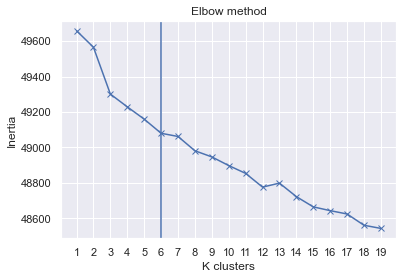

In [210]:
plt.plot(ks.keys(), ks.values(), 'bx-')
plt.title('Elbow method')
plt.xlabel('K clusters')
plt.ylabel('Inertia')
plt.xticks(range(1, 20));
plt.axvline(6);

In [194]:
tweets_model[tweets_model['date'].dt.year == 2019].head()

,user,date,content,text_clean,pp,emojis
560086,elespectador,2019-01-26 17:30:02+00:00,Investigan homicidio del líder social Samuel G...,Investigan homicidio del líder social Samuel G...,investigan homicidio líder social samuel gallo...,[]
497629,elespectador,2019-10-14 09:30:24+00:00,La millonaria multa a Johnson &amp; Johnson po...,La millonaria multa a Johnson &amp; Johnson po...,millonaria multa johnson amp johnson advertir ...,[]
291777,Citytv,2019-04-30 00:00:10+00:00,Este viernes vence plazo para pagar impuesto d...,Este viernes vence plazo para pagar impuesto d...,viernes vence plazo pagar impuesto carro descu...,[]
531057,elespectador,2019-05-23 21:42:00+00:00,“La minería a gran escala amenaza el territori...,“La minería a gran escala amenaza el territori...,minería gran escala amenaza territorio vida pu...,[]
659150,PrensaLaNacion,2019-03-02 23:40:01+00:00,#Niños Siempre han existido dudas en torno a l...,Siempre han existido dudas en torno a la educ...,siempre existido dudas torno educación menores...,[]


## LDA 2019

In [209]:
tweets['pp_list'] = tweets['pp'].str.split()

In [218]:
dictionary = Dictionary(tweets[tweets['date'].dt.year == 2019]['pp_list'].values)
dictionary.filter_extremes(no_below = 5, no_above = .5)
corpus = [dictionary.doc2bow(text) for text in tweets[tweets['date'].dt.year == 2019]['pp_list'].values]

In [219]:
%%time
model_2019 = LdaModel(corpus = corpus, id2word = dictionary, num_topics = 6, passes = 100)

Wall time: 1h 36min 33s


In [220]:
model_2019.print_topics(num_words = 10)

[(0,
  '0.013*"colombia" + 0.011*"país" + 0.009*"año" + 0.008*"millones" + 0.007*"gobierno" + 0.007*"opinión" + 0.007*"semana" + 0.007*"conozca" + 0.006*"américa" + 0.006*"presidente"'),
 (1,
  '0.015*"días" + 0.013*"barranquilla" + 0.013*"millones" + 0.012*"buenos" + 0.011*"bogotá" + 0.010*"junior" + 0.009*"economía" + 0.008*"mundial" + 0.005*"personas" + 0.005*"operaciones"'),
 (2,
  '0.011*"ee" + 0.011*"uu" + 0.010*"dólar" + 0.010*"trump" + 0.009*"acción" + 0.009*"venezuela" + 0.008*"leer" + 0.008*"plan" + 0.008*"colombia" + 0.007*"espere"'),
 (3,
  '0.025*"información" + 0.022*"hoy" + 0.016*"día" + 0.014*"mundo" + 0.013*"así" + 0.013*"abre" + 0.012*"colombia" + 0.011*"edición" + 0.011*"lea" + 0.011*"invitamos"'),
 (4,
  '0.016*"colombia" + 0.014*"venezuela" + 0.009*"maduro" + 0.007*"bursátil" + 0.007*"china" + 0.007*"precio" + 0.007*"guaidó" + 0.007*"santa" + 0.006*"mercado" + 0.006*"crisis"'),
 (5,
  '0.017*"años" + 0.011*"dos" + 0.007*"unidades" + 0.007*"cinco" + 0.007*"caso" + 0

In [221]:
lda_display = pyLDAvis.gensim_models.prepare(model_2019, corpus, dictionary)
pyLDAvis.display(lda_display)

## LDA 2020

In [215]:
dictionary = Dictionary(tweets[tweets['date'].dt.year == 2020]['pp_list'].values)
dictionary.filter_extremes(no_below = 5, no_above = .5)
corpus = [dictionary.doc2bow(text) for text in tweets[tweets['date'].dt.year == 2020]['pp_list'].values]

In [216]:
%%time
model_2020 = LdaModel(corpus = corpus, id2word = dictionary, num_topics = 6, passes = 50)

Wall time: 57min 52s


In [217]:
model_2020.print_topics(num_words = 10)
lda_display = pyLDAvis.gensim_models.prepare(model_2020, corpus, dictionary)
pyLDAvis.display(lda_display)